In [ ]:
import torch
import torch.optim as optim
from torch.utils.tensorboard import SummaryWriter
import numpy as np
import os
import argparse
import time
from im2scene import config
from im2scene.checkpoints import CheckpointIO
import logging
logger_py = logging.getLogger(__name__)
np.random.seed(0)
torch.manual_seed(0)

# Arguments
cfg = config.load_config('configs/64res/cars_64.yaml', 'configs/default.yaml')
device = torch.device("cuda")

# Shorthands
out_dir = cfg['training']['out_dir']
backup_every = cfg['training']['backup_every']
lr = cfg['training']['learning_rate']
lr_d = cfg['training']['learning_rate_d']
batch_size = cfg['training']['batch_size']
n_workers = cfg['training']['n_workers']
t0 = time.time()

model_selection_metric = cfg['training']['model_selection_metric']
if cfg['training']['model_selection_mode'] == 'maximize':
    model_selection_sign = 1
elif cfg['training']['model_selection_mode'] == 'minimize':
    model_selection_sign = -1
else:
    raise ValueError('model_selection_mode must be '
                     'either maximize or minimize.')

# Output directory
if not os.path.exists(out_dir):
    os.makedirs(out_dir)

train_dataset = config.get_dataset(cfg)
train_loader = torch.utils.data.DataLoader(
    train_dataset, batch_size=batch_size, num_workers=n_workers, shuffle=True,
    pin_memory=True, drop_last=True,
)

model = config.get_model(cfg, device=device, len_dataset=len(train_dataset))


# Initialize training
op = optim.RMSprop if cfg['training']['optimizer'] == 'RMSprop' else optim.Adam
optimizer_kwargs = cfg['training']['optimizer_kwargs']

if hasattr(model, "generator") and model.generator is not None:
    parameters_g = model.generator.parameters()
else:
    parameters_g = list(model.decoder.parameters())
optimizer = op(parameters_g, lr=lr, **optimizer_kwargs)

if hasattr(model, "discriminator") and model.discriminator is not None:
    parameters_d = model.discriminator.parameters()
    optimizer_d = op(parameters_d, lr=lr_d)
else:
    optimizer_d = None

trainer = config.get_trainer(model, optimizer, optimizer_d, cfg, device=device)
checkpoint_io = CheckpointIO(out_dir, model=model, optimizer=optimizer,
                             optimizer_d=optimizer_d)
try:
    load_dict = checkpoint_io.load('model.pt')
    print("Loaded model checkpoint.")
except FileExistsError:
    load_dict = dict()
    print("No model checkpoint found.")

epoch_it = load_dict.get('epoch_it', -1)
it = load_dict.get('it', -1)
metric_val_best = load_dict.get(
    'loss_val_best', -model_selection_sign * np.inf)

if metric_val_best == np.inf or metric_val_best == -np.inf:
    metric_val_best = -model_selection_sign * np.inf

print('Current best validation metric (%s): %.8f'
      % (model_selection_metric, metric_val_best))

logger = SummaryWriter(os.path.join(out_dir, 'logs'))
# Shorthands
print_every = cfg['training']['print_every']
checkpoint_every = cfg['training']['checkpoint_every']
validate_every = cfg['training']['validate_every']
visualize_every = cfg['training']['visualize_every']

# Print model
nparameters = sum(p.numel() for p in model.parameters())
logger_py.info(model)
logger_py.info('Total number of parameters: %d' % nparameters)

if hasattr(model, "discriminator") and model.discriminator is not None:
    nparameters_d = sum(p.numel() for p in model.discriminator.parameters())
    logger_py.info(
        'Total number of discriminator parameters: %d' % nparameters_d)
if hasattr(model, "generator") and model.generator is not None:
    nparameters_g = sum(p.numel() for p in model.generator.parameters())
    logger_py.info('Total number of generator parameters: %d' % nparameters_g)

t0b = time.time()

while True:
    epoch_it += 1

    for batch in train_loader:

        it += 1
        loss = trainer.train_step(batch, it)
        for (k, v) in loss.items():
            logger.add_scalar(k, v, it)
        # Print output
        if print_every > 0 and (it % print_every) == 0:
            info_txt = '[Epoch %02d] it=%03d, time=%.3f' % (
                epoch_it, it, time.time() - t0b)
            for (k, v) in loss.items():
                info_txt += ', %s: %.4f' % (k, v)
            logger_py.info(info_txt)
            t0b = time.time()

        # # Visualize output
        if visualize_every > 0 and (it % visualize_every) == 0:
            logger_py.info('Visualizing')
            image_grid = trainer.visualize(it=it)
            if image_grid is not None:
                logger.add_image('images', image_grid, it)

        # Save checkpoint
        if (checkpoint_every > 0 and (it % checkpoint_every) == 0):
            logger_py.info('Saving checkpoint')
            print('Saving checkpoint')
            checkpoint_io.save('model.pt', epoch_it=epoch_it, it=it,
                               loss_val_best=metric_val_best)

        # Backup if necessary
        if (backup_every > 0 and (it % backup_every) == 0):
            logger_py.info('Backup checkpoint')
            checkpoint_io.save('model_%d.pt' % it, epoch_it=epoch_it, it=it,
                               loss_val_best=metric_val_best)

        # Run validation
        if validate_every > 0 and (it % validate_every) == 0 and (it > 0):
            print("Performing evaluation step.")
            eval_dict = trainer.evaluate()
            metric_val = eval_dict[model_selection_metric]
            logger_py.info('Validation metric (%s): %.4f'
                           % (model_selection_metric, metric_val))

            for k, v in eval_dict.items():
                logger.add_scalar('val/%s' % k, v, it)

            if model_selection_sign * (metric_val - metric_val_best) > 0:
                metric_val_best = metric_val
                logger_py.info('New best model (loss %.4f)' % metric_val_best)
                checkpoint_io.backup_model_best('model_best.pt')
                checkpoint_io.save('model_best.pt', epoch_it=epoch_it, it=it,
                                   loss_val_best=metric_val_best)

        if it > 100:
            exit(3)

checkpoint_io.save('model.pt', epoch_it=epoch_it, it=it, loss_val_best=metric_val_best)

Start loading file addresses ...


[(levelname)s] GIRAFFE(
  (discriminator): DCDiscriminator(
    (blocks): ModuleList(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (2): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (3): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    )
    (conv_out): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (actvn): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (generator): Generator(
    (bounding_box_generator): BoundingBoxGenerator()
    (decoder): Decoder(
      (fc_in): Linear(in_features=60, out_features=128, bias=True)
      (fc_z): Linear(in_features=256, out_features=128, bias=True)
      (blocks): ModuleList(
        (0): Linear(in_features=128, out_features=128, bias=True)
        (1): Linear(in_features=128, out_features=128, bias=True)
        (2):

done! time: 0.2345595359802246
Number of images found: 136726
out/cars64/model.pt
=> Loading checkpoint from local file...
Loaded model checkpoint.
Current best validation metric (fid_score): inf


[(levelname)s] [Epoch 01] it=010, time=10.989, generator: 0.7065, discriminator: 1.3785, regularizer: 0.0023
[(levelname)s] [Epoch 01] it=020, time=3.126, generator: 0.8761, discriminator: 1.3798, regularizer: 0.0251
[(levelname)s] [Epoch 01] it=030, time=2.920, generator: 0.7041, discriminator: 1.3576, regularizer: 0.0151
[(levelname)s] [Epoch 01] it=040, time=3.004, generator: 0.6773, discriminator: 1.3614, regularizer: 0.0086
[(levelname)s] [Epoch 01] it=050, time=4.348, generator: 0.7220, discriminator: 1.3584, regularizer: 0.0075
[(levelname)s] [Epoch 01] it=060, time=3.069, generator: 0.6628, discriminator: 1.3088, regularizer: 0.0261
[(levelname)s] [Epoch 01] it=070, time=3.224, generator: 0.6159, discriminator: 1.3358, regularizer: 0.0298
[(levelname)s] [Epoch 01] it=080, time=2.689, generator: 0.6754, discriminator: 1.3494, regularizer: 0.0148
[(levelname)s] [Epoch 01] it=090, time=4.890, generator: 0.6511, discriminator: 1.3637, regularizer: 0.0129
[(levelname)s] [Epoch 01] i

In [2]:
import torch
import os
from im2scene import config
from im2scene.checkpoints import CheckpointIO

cfg = config.load_config('configs/64res/cars_64_pretrained.yaml', 'configs/default.yaml')
device = torch.device("cuda")
out_dir = cfg['training']['out_dir']
render_dir = os.path.join(out_dir, cfg['rendering']['render_dir'])
if not os.path.exists(render_dir):
    os.makedirs(render_dir)

# Model
model = config.get_model(cfg, device=device)

checkpoint_io = CheckpointIO(out_dir, model=model)
checkpoint_io.load(cfg['test']['model_file'])

# Generator
renderer = config.get_renderer(model, cfg, device=device)

model.eval()
out = renderer.render_full_visualization(
    render_dir,
    cfg['rendering']['render_program'])

https://s3.eu-central-1.amazonaws.com/avg-projects/giraffe/models/checkpoint_compcars64-e85060a0.pt
=> Loading checkpoint from url...


/home/minh/anaconda3/envs/giraffe/lib/python3.8/site-packages/torch/functional.py:568: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2228.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (332, 200) to (336, 208) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).
[swscaler @ 0x55739b790940] Warning: data is not aligned! This can lead to a speed loss
IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (596, 68) to (608, 80) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size

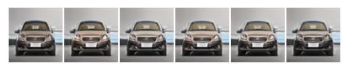

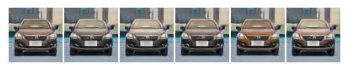

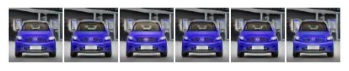

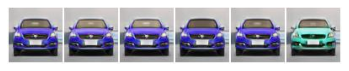

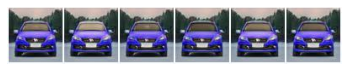

...

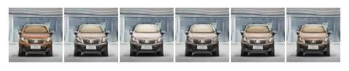

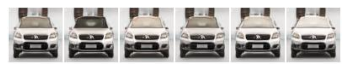

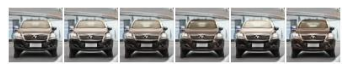

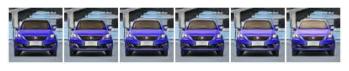

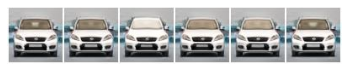

In [16]:
from matplotlib import pyplot as plt
import cv2
for i in range(15):
    img = cv2.imread(f'out/cars64_pretrained/rendering/interpolate_app/{i:04d}_interpolate_app.jpg')
    plt.imshow(img)
    plt.axis('off')
    plt.show()

In [36]:
from IPython.core.display import Image
from moviepy.editor import VideoFileClip

for gan_type in ['rotation_object', 'interpolate_shape', 'translation_object_horizontal', 'translation_object_depth']:
    print('\n', gan_type)
    file_name = gan_type.replace("_object", "") if 'translation' in gan_type else gan_type
    video_file = f'out/cars64_pretrained/rendering/{gan_type}/{file_name}.mp4'
    clip = (VideoFileClip(video_file))
    gif_file = f'{os.path.dirname(video_file)}/{file_name}.gif'
    clip.write_gif(gif_file)

t:   0%|          | 0/64 [00:00<?, ?it/s, now=None]


 rotation_object
MoviePy - Building file out/cars64_pretrained/rendering/rotation_object/rotation_object.gif with imageio.


t:   0%|          | 0/192 [00:00<?, ?it/s, now=None]        


 interpolate_shape
MoviePy - Building file out/cars64_pretrained/rendering/interpolate_shape/interpolate_shape.gif with imageio.


t:   0%|          | 0/64 [00:00<?, ?it/s, now=None]           


 translation_object_horizontal
MoviePy - Building file out/cars64_pretrained/rendering/translation_object_horizontal/translation_horizontal.gif with imageio.


t:   0%|          | 0/64 [00:00<?, ?it/s, now=None]         


 translation_object_depth
MoviePy - Building file out/cars64_pretrained/rendering/translation_object_depth/translation_depth.gif with imageio.


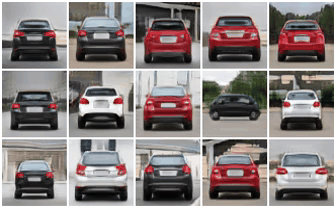

In [38]:
gan_type = 'rotation_object'
file_name = gan_type.replace("_object", "") if 'translation' in gan_type else gan_type
gif_file = f'out/cars64_pretrained/rendering/{gan_type}/{file_name}.gif'
Image(filename=gif_file)

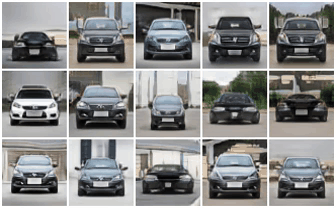

In [39]:
gan_type = 'interpolate_shape'
file_name = gan_type.replace("_object", "") if 'translation' in gan_type else gan_type
gif_file = f'out/cars64_pretrained/rendering/{gan_type}/{file_name}.gif'
Image(filename=gif_file)

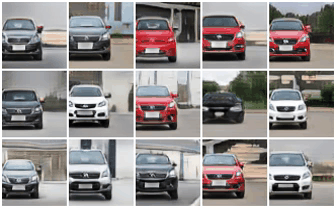

In [40]:
gan_type = 'translation_object_horizontal'
file_name = gan_type.replace("_object", "") if 'translation' in gan_type else gan_type
gif_file = f'out/cars64_pretrained/rendering/{gan_type}/{file_name}.gif'
Image(filename=gif_file)

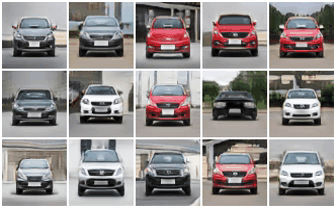

In [41]:
gan_type = 'translation_object_depth'
file_name = gan_type.replace("_object", "") if 'translation' in gan_type else gan_type
gif_file = f'out/cars64_pretrained/rendering/{gan_type}/{file_name}.gif'
Image(filename=gif_file)